# Równania różniczkowe zwyczajne
## Wprowadzenie do wszystkich zadań
    
* Zadanie polega na numerycznym rozwiązaniu  danego równania różniczkowego zwyczajnego.
* Należy napisać wlasną implementację metody Eulera 
* porównać ją z  metodą  Rungego-Kutty  (np. dostępną  w dowolnym pakiecie numerycznym - dla tych, co lubia Julię - polecam pakiet DifferentialEquations (https://diffeq.sciml.ai/stable/)) dla zadanego na zajęciach równania. 
* <b>Należy zbadać  stabilność  metod dla różnych wielkości kroków czasowych.</b>

## Punkty:

* Rozwiązanie metodą Eulera (1pkt)
* Rozwiązanie metodą Rungego-Kutty (1 pkt)
* Porównanie stabilności (1 pkt)
* Ciekawa animacja poza standardowymi wykresami f(t) (1 pkt)
* Ewentualne rozszerzenie (extra 3 pkt)

# Used packages

In [1]:
using Pkg
#Pkg.add("DifferentialEquations")
#Pkg.add("SciMLBase")
#Pkg.add("OrdinaryDiffEq")

using LinearAlgebra
using Plots
using SciMLBase
using DifferentialEquations
using OrdinaryDiffEq

# Sources
http://www.artcompsci.org/msa/web/vol_1/v1_web/v1_web.html

## Formulas
Version for 2-body problem
In the following simulations we use relative coordinates, ie. object 1 always has position (0, 0, 0) and velocity (0, 0, 0)

Newton's gravitational equation:
$$\frac{d^2}{dt^2}\vec{r} = -G\frac{M_1 + M_2}{r^3}\vec{r}$$
where:
$$\vec{r} = (x, y, z)$$
$$r = |\vec{r}| = \sqrt{x^2+y^2+z^2}$$
Note, that:
$$\vec{v} = \frac{dr}{dt}$$
$$\vec{a} = \frac{dv}{dt} = \frac{d^2r}{dt^2}$$

# Initial conditions

In [2]:
G = 1.0  # Gravitational constant - [N*m^2/kg^2]
m1 = 40.0  # Mass of object 1 - [kg]
m2 = 1.0  # Mass of object 2 - [kg]
dimensions = 3
r = [1.0, 2.0, 3.0]  # Relative initial position object 2 - [m]^dimensions
v = [0.0, -0.1, 0.2]  # Relative initial velocity of object 2 - [m/s]^dimensions

dt = 0.01  # Time step - [s]
simulation_time = 100  # Total simulation time [s]
n_steps = Int(round(simulation_time / dt))  # Total simulation steps
;

# Plotting functions

In [3]:
function plot_position_2d(r_values) 
    plot(r_values[:,1], r_values[:,2], label = "Object 2")
    scatter!((0, 0), label="Object 1")
    return plot!(xlabel = "x [m]", ylabel = "y [m]", zlabel = "z [m]", title = "Position of object 2 relative to object 1")
end

function plot_position_3d(r_values)
    plot(r_values[:,1], r_values[:,2], r_values[:,3], label = "Object 2")
    scatter!((0, 0, 0), label="Object 1")
    return plot!(xlabel = "x [m]", ylabel = "y [m]", zlabel="z [m]", title = "Position of object 2 relative to object 1")
end

function plot_velocity_2d(v_values)
    plot(v_values[:,1], v_values[:,2], label = "Object 2")
    scatter!((0, 0), label="Object 1")
    return plot!(xlabel = "x [m]", ylabel = "y [m]", title = "Velocity of object 2 relative to object 1")
end

function plot_velocity_3d(v_values)
    plot(v_values[:,1], v_values[:,2], v_values[:,3], label = "Object 2")
    scatter!((0, 0, 0), label="Object 1")
    return plot!(xlabel = "x [m]", ylabel = "y [m]", zlabel = "z [m]", title = "Velocity of object 2 relative to object 1")
end
;

In [4]:
function calculate_kinetic_energy_vector(v_values)
    n_steps = size(v_values)[1]-1
    E_kin = zeros(n_steps+1)
    for i in 1:n_steps
        E_kin[i+1] = norm(v_values[i,:])^2 / 2
    end
    return E_kin
end

function calculate_potential_energy_vector(r_values, G)
    n_steps = size(r_values)[1]-1
    E_pot = zeros(n_steps+1)
    for i in 1:n_steps
        E_pot[i+1] = -G / norm(r_values[i,:])    
    end
    return E_pot
end

function plot_total_energy_in_respect_to_reduced_mass(r_values, v_values, G)
    E_kin = calculate_kinetic_energy_vector(v_values)
    E_pot = calculate_potential_energy_vector(r_values, G)
    E_tot = E_kin + E_pot
    
    plot(E_tot, label="Total energy")
    plot!(E_kin, label="Kinetic energy")
    plot!(E_pot, label="Potential energy")
    return plot!(xlabel = "simulation step", ylabel = "energy [J]", title = "System energy with respect to the reduced mass")
end

function calculate_total_energy_relative_difference(E_tot)
    return (E_tot[end-1] - E_tot[2]) / E_tot[2]
end
;

# Euler algorithm

In [5]:
function euler(n_steps, dimensions, r, v, G, m1, m2, dt)
    r_values = zeros(n_steps+1, dimensions)
    v_values = zeros(n_steps+1, dimensions)

    # Set the initial values
    r_values[1, :] = r
    v_values[1, :] = v


    # Euler integration
    for i in 1:n_steps
        # Distance between the objects
        r_norm = norm(r_values[i,:])

        # Gravitational acceleration
        a = -(G * m2 / r_norm^3) * r_values[i,:]

        # Update the velocities and positions
        v_values[i+1, :] = v_values[i, :] + a * dt
        r_values[i+1, :] = r_values[i, :] + v_values[i+1, :] * dt
    end
    return r_values, v_values
end

euler (generic function with 1 method)

## Solve with Euler

In [6]:
r_values, v_values = euler(n_steps, dimensions, r, v, G, m1, m2, dt);

## Position

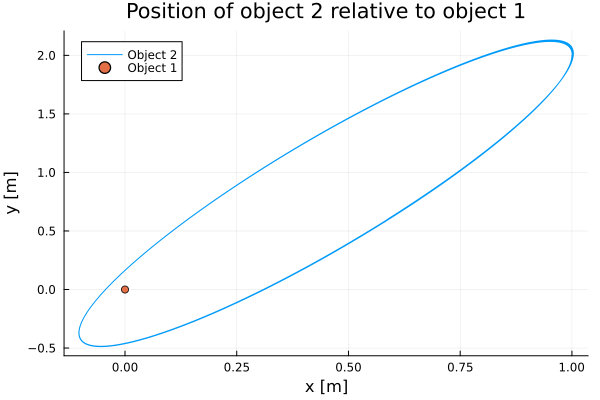

In [7]:
plot_position_2d(r_values)

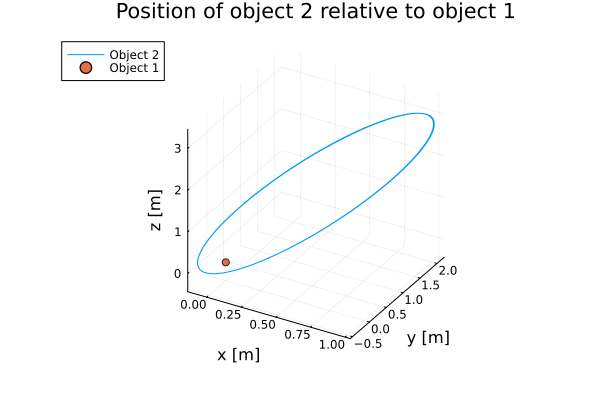

In [8]:
plot_position_3d(r_values)

## Velocity

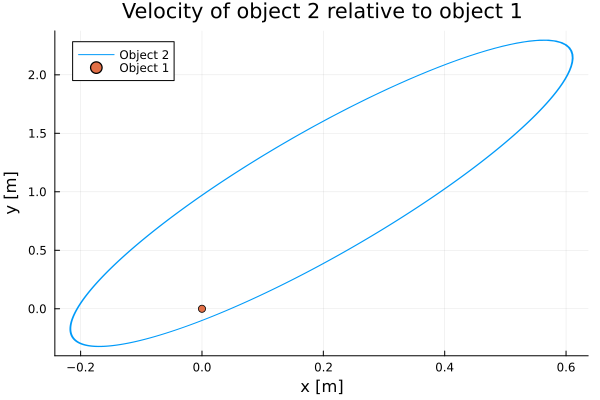

In [9]:
plot_velocity_2d(v_values)

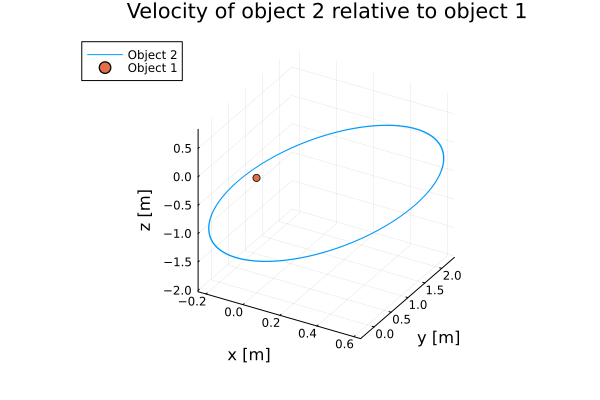

In [10]:
plot_velocity_3d(v_values)

## Energy

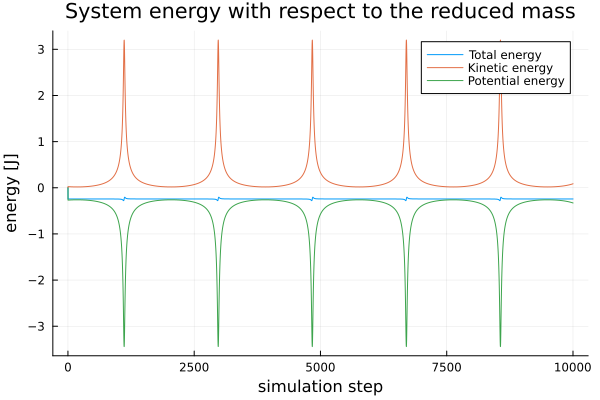

In [11]:
plot_total_energy_in_respect_to_reduced_mass(r_values, v_values, G)

In [12]:
E_tot = calculate_kinetic_energy_vector(v_values) + calculate_potential_energy_vector(r_values, G)
calculate_total_energy_relative_difference(E_tot)

0.0009139783679524373

# Runge-Kutta method

In [13]:
function runge_kutta(n_steps, dimensions, r, v, G, m1, m2, dt, adaptive=false)
    function two_body_gravitational!(du, u, p, t)
        r = u[1:p.dimensions]
        v = u[p.dimensions+1:end]
        r_norm = norm(r)
        a = -(p.G * p.m2 / r_norm^3) * r
        du[1:p.dimensions] = v
        du[p.dimensions+1:end] = a
    end

    # Initial values
    u0 = vcat(r, v)

    tspan = (0.0, dt * n_steps)

    # The ODE problem
    p = (G=G, m2=m2, dimensions=dimensions)
    prob = ODEProblem(two_body_gravitational!, u0, tspan, p)

    # Solve the ODE problem using the Runge-Kutta method
    if adaptive
        sol = solve(prob, Tsit5())
    else
        sol = solve(prob, Tsit5(), saveat=dt, dt=dt)
    end

    # Extract the solution values
    r_values = permutedims(sol[1:dimensions, :], (2, 1))
    v_values = permutedims(sol[dimensions+1:end, :], (2, 1))
    return r_values, v_values
end;

## Solve with Runge-Kutta method

In [14]:
r_values, v_values = runge_kutta(n_steps, dimensions, r, v, G, m1, m2, dt);

## Position

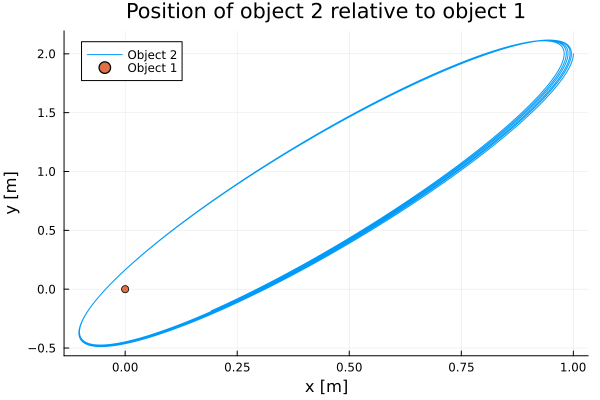

In [15]:
plot_position_2d(r_values)

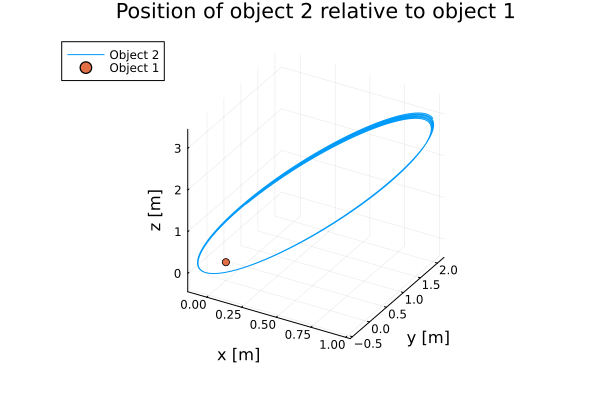

In [16]:
plot_position_3d(r_values)

## Velocity

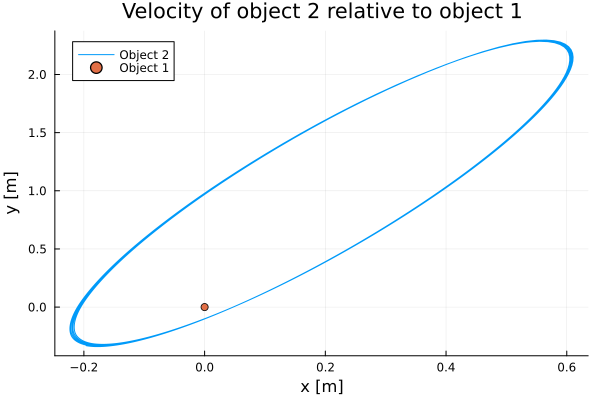

In [17]:
plot_velocity_2d(v_values)

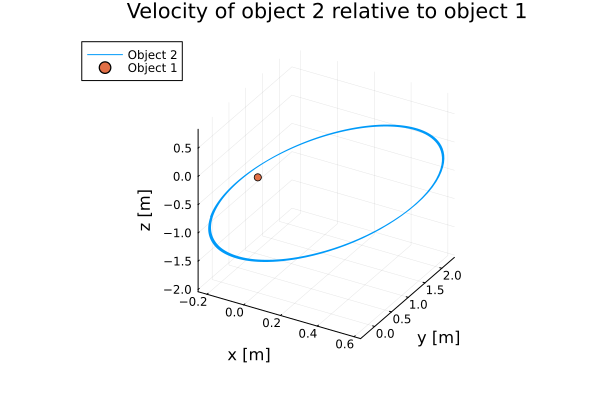

In [18]:
plot_velocity_3d(v_values)

## Energy

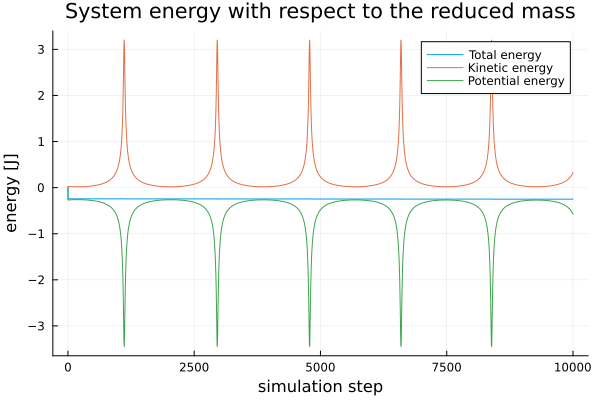

In [19]:
plot_total_energy_in_respect_to_reduced_mass(r_values, v_values, G)

In [20]:
E_tot = calculate_kinetic_energy_vector(v_values) + calculate_potential_energy_vector(r_values, G)
calculate_total_energy_relative_difference(E_tot)

0.03220397234216491

# Stability
We will check stability of these algorithms regarding the energy conservation law, ie. change in total energy of a system will be interpreted as depravation from the true solution.

## Functions

In [21]:
function calculate_euler_total_energy_relative_difference(dt_max, dt_min, dt_step, n_steps)
    dt_range = dt_min:dt_step:dt_max
    dt_steps_total = length(dt_range)
    
    E_tot_euler_relative_diff = zeros(dt_steps_total, 2)
    for (i, dt) in enumerate(dt_range)
        r_values, v_values = euler(n_steps, dimensions, r, v, G, m1, m2, dt)
        E_tot = calculate_kinetic_energy_vector(v_values) + calculate_potential_energy_vector(r_values, G)
        E_tot_euler_relative_diff[i, 1] = dt
        E_tot_euler_relative_diff[i, 2] = abs(calculate_total_energy_relative_difference(E_tot))
    end
    return E_tot_euler_relative_diff
end

function calculate_runge_kutta_total_energy_relative_difference(dt_max, dt_min, dt_step, n_steps)
    dt_range = dt_min:dt_step:dt_max
    dt_steps_total = length(dt_range)
    
    E_tot_runge_kutta_relative_diff = zeros(dt_steps_total, 2)
    for (i, dt) in enumerate(dt_range)
        r_values, v_values = runge_kutta(n_steps, dimensions, r, v, G, m1, m2, dt)
        E_tot = calculate_kinetic_energy_vector(v_values) + calculate_potential_energy_vector(r_values, G)
        E_tot_runge_kutta_relative_diff[i, 1] = dt
        E_tot_runge_kutta_relative_diff[i, 2] = abs(calculate_total_energy_relative_difference(E_tot))
    end

    return E_tot_runge_kutta_relative_diff
end

calculate_runge_kutta_total_energy_relative_difference (generic function with 1 method)

## Stability check

In [22]:
dt_max = 0.15
dt_min = 0.01
dt_step = 0.01
dt_range = dt_min:dt_step:dt_max
dt_steps_total = length(dt_range)
n_steps = 10000;

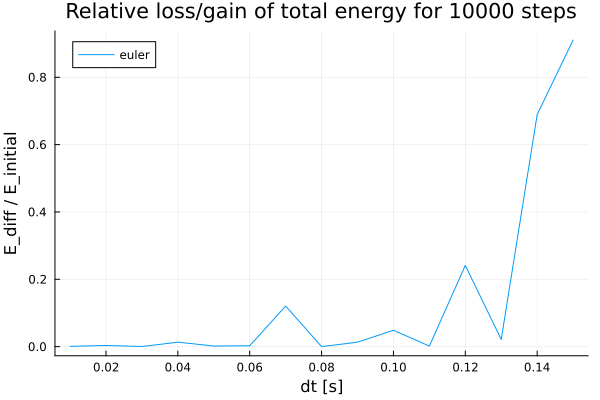

In [23]:
E_tot_euler_relative_diff = calculate_euler_total_energy_relative_difference(dt_max, dt_min, dt_step, n_steps)

plot(title="Relative loss/gain of total energy for " * string(n_steps) * " steps",
    xlabel = "dt [s]",
    ylabel = "E_diff / E_initial")
plot!(E_tot_euler_relative_diff[:,1], E_tot_euler_relative_diff[:,2], label="euler")

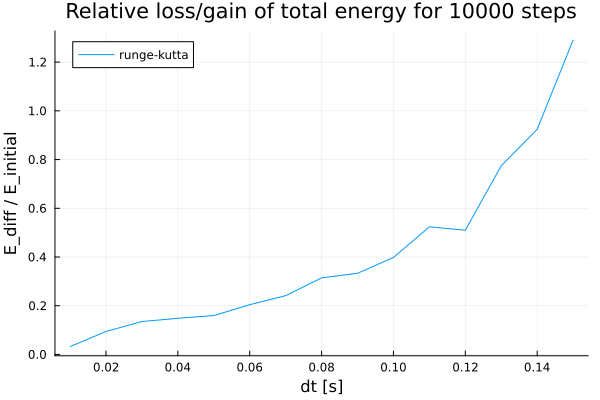

In [24]:
E_tot_runge_kutta_relative_diff = calculate_runge_kutta_total_energy_relative_difference(dt_max, dt_min, dt_step, n_steps)

plot(title="Relative loss/gain of total energy for " * string(n_steps) * " steps",
    xlabel = "dt [s]",
    ylabel = "E_diff / E_initial")
plot!(E_tot_runge_kutta_relative_diff[:,1], E_tot_runge_kutta_relative_diff[:,2], label = "runge-kutta")

In [25]:
dt_max = 0.006
dt_min = 0.0001
dt_step = 0.0001
dt_range = dt_min:dt_step:dt_max
dt_steps_total = length(dt_range)
n_steps = 10000;

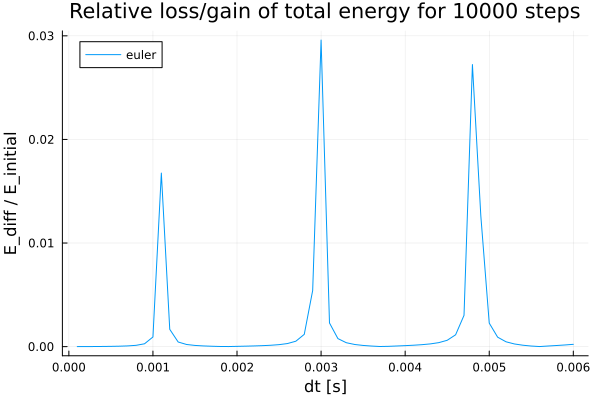

In [26]:
E_tot_euler_relative_diff = calculate_euler_total_energy_relative_difference(dt_max, dt_min, dt_step, n_steps)

plot(title="Relative loss/gain of total energy for " * string(n_steps) * " steps",
    xlabel = "dt [s]",
    ylabel = "E_diff / E_initial")
plot!(E_tot_euler_relative_diff[:,1], E_tot_euler_relative_diff[:,2], label="euler")

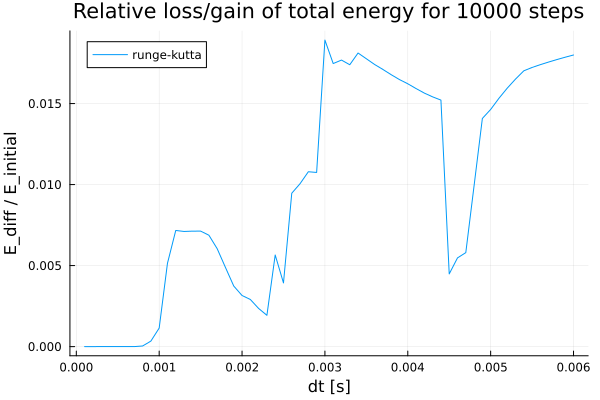

In [27]:
E_tot_runge_kutta_relative_diff = calculate_runge_kutta_total_energy_relative_difference(dt_max, dt_min, dt_step, n_steps)

plot(title="Relative loss/gain of total energy for " * string(n_steps) * " steps",
    xlabel = "dt [s]",
    ylabel = "E_diff / E_initial")
plot!(E_tot_runge_kutta_relative_diff[:,1], E_tot_runge_kutta_relative_diff[:,2], label = "runge-kutta")

In [28]:
dt_max = 0.0006
dt_min = 0.00001
dt_step = 0.00001
dt_range = dt_min:dt_step:dt_max
dt_steps_total = length(dt_range)
n_steps = 10000;

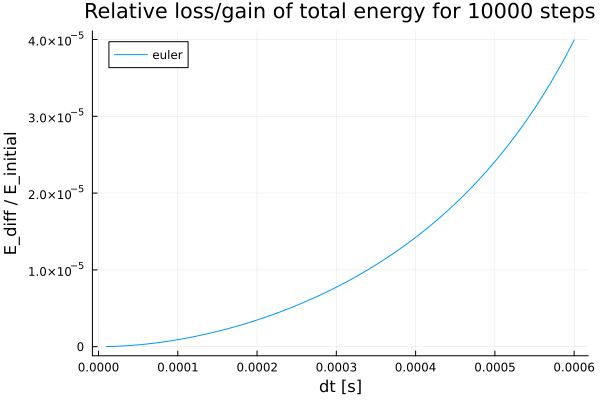

In [29]:
E_tot_euler_relative_diff = calculate_euler_total_energy_relative_difference(dt_max, dt_min, dt_step, n_steps)

plot(title="Relative loss/gain of total energy for " * string(n_steps) * " steps",
    xlabel = "dt [s]",
    ylabel = "E_diff / E_initial")
plot!(E_tot_euler_relative_diff[:,1], E_tot_euler_relative_diff[:,2], label="euler")

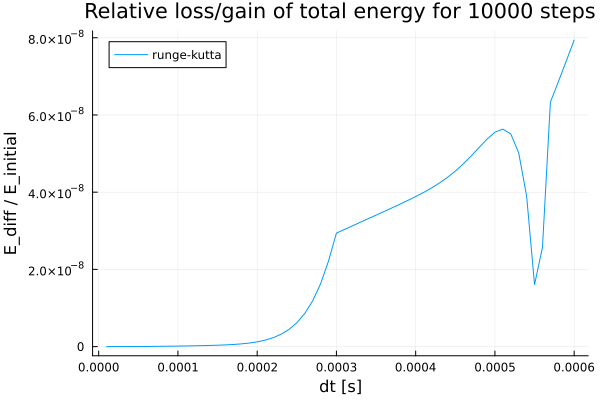

In [30]:
E_tot_runge_kutta_relative_diff = calculate_runge_kutta_total_energy_relative_difference(dt_max, dt_min, dt_step, n_steps)

plot(title="Relative loss/gain of total energy for " * string(n_steps) * " steps",
    xlabel = "dt [s]",
    ylabel = "E_diff / E_initial")
plot!(E_tot_runge_kutta_relative_diff[:,1], E_tot_runge_kutta_relative_diff[:,2], label = "runge-kutta")

## Conclusion
Euler's method seems to perform better for larger timesteps, but with Runge-Kutta method the energy error decreases quicker as $dt \rightarrow 0$
Additionaly, Euler's method experiences "spikes" in energy error near peryheliums, where kinetic energy increases and potential energy decreases rapidly

# Animation

## Initial parameters

In [31]:
G = 1.0  # Gravitational constant - [N*m^2/kg^2]
m1 = 40.0  # Mass of object 1 - [kg]
m2 = 1.0  # Mass of object 2 - [kg]
dimensions = 3
r = [1.0, 2.0, 3.0]  # Relative initial position object 2 - [m]^dimensions
v = [0.1, -0.1, 0.2]  # Relative initial velocity of object 2 - [m/s]^dimensions

dt = 0.014  # Time step - [s]
simulation_time = 25  # Total simulation time [s]
n_steps = Int(round(simulation_time / dt))  # Total simulation steps
;

## Simulation

In [32]:
r_values, v_values = euler(n_steps, dimensions, r, v, G, m1, m2, dt)

E_tot = calculate_kinetic_energy_vector(v_values) + calculate_potential_energy_vector(r_values, G)
calculate_total_energy_relative_difference(E_tot)

0.0007550781088959077

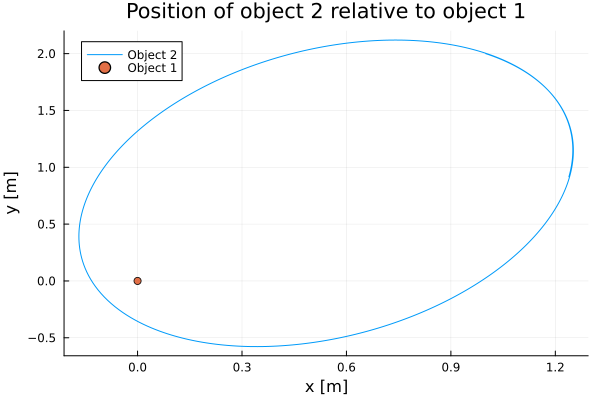

In [33]:
plot_position_2d(r_values)

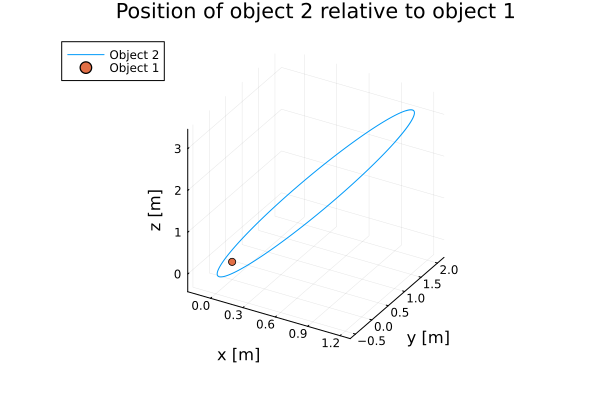

In [34]:
plot_position_3d(r_values)

## Animating functions

In [35]:
function animate_position_2d(r_values)
    min_x, max_x = extrema(r_values[:,1])
    min_y, max_y = extrema(r_values[:,2])

    plt = scatter((0, 0),
        color=:red,
        xlims=(min_x, max_x),
        ylims=(min_y, max_y),
        title="Simulation of position for object 2 relative to object 1",
        xlabel = "x [m]",
        ylabel = "y [m]")

    frames = @animate for i in 1:size(r_values)[1]
        x = [r_values[i, 1]]
        y = [r_values[i, 2]]

        scatter!(plt, x, y, markersize=4, legend=false, color=:blue)

        plt
    end every 20

    return frames
end;

In [36]:
function animate_position_3d(r_values)
    min_x, max_x = extrema(r_values[:,1])
    min_y, max_y = extrema(r_values[:,2])
    min_z, max_z = extrema(r_values[:,3])

    plt = scatter((0, 0, 0),
        color=:red,
        xlims=(min_x, max_x),
        ylims=(min_y, max_y),
        zlims=(min_z, max_z),
        title="Simulation of position for object 2 relative to object 1",
        xlabel = "x [m]",
        ylabel = "y [m]",
        zlabel = "z [m]")

    frames = @animate for i in 1:size(r_values)[1]
        x = [r_values[i, 1]]
        y = [r_values[i, 2]]
        z = [r_values[i, 3]]

        scatter!(plt, x, y, z, markersize=4, legend=false, color=:blue)

        plt
    end every 20

    return frames
end;

## Position 2d

[ Info: Saved animation to C:\Users\filip\Documents\Studia\MOwNiT\lab10\animation_position_2d.gif


Plots.AnimatedGif("C:\\Users\\filip\\Documents\\Studia\\MOwNiT\\lab10\\animation_position_2d.gif")
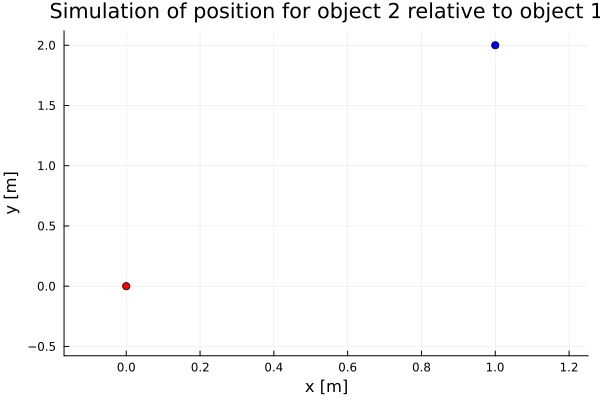

In [37]:
animate_position_2d(r_values)
animation = animate_position_2d(r_values);
gif(animation, "animation_position_2d.gif")

## Position 3d

[ Info: Saved animation to C:\Users\filip\Documents\Studia\MOwNiT\lab10\animation_position_3d.gif


Plots.AnimatedGif("C:\\Users\\filip\\Documents\\Studia\\MOwNiT\\lab10\\animation_position_3d.gif")
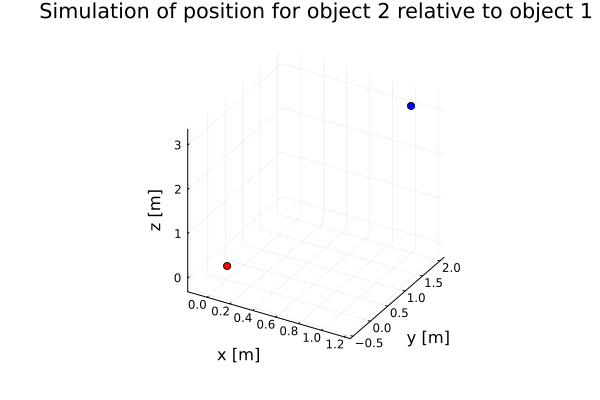

In [38]:
animate_position_3d(r_values)
animation = animate_position_3d(r_values);
gif(animation, "animation_position_3d.gif")

# Extention: 3-body problem

## Trying with Euler Algorithm

I tried using Euler algorithm, but it quickly turned out that 3-body problem is much more sensitive, so I had to use other algorithm, which would respect total energy without requiring ridicolously small time step.

Nonetheless I didn't remove my code:

In [39]:
function euler2(n_steps, dimensions, r1, r2, r3, v1, v2, v3, G, m1, m2, m3, dt)
    r1_values = zeros(n_steps+1, dimensions)
    r2_values = zeros(n_steps+1, dimensions)
    r3_values = zeros(n_steps+1, dimensions)
    v1_values = zeros(n_steps+1, dimensions)
    v2_values = zeros(n_steps+1, dimensions)
    v3_values = zeros(n_steps+1, dimensions)

    r1_values[1, :] = r1
    r2_values[1, :] = r2
    r3_values[1, :] = r3
    v1_values[1, :] = v1
    v2_values[1, :] = v2
    v3_values[1, :] = v3

    # Euler integration
    for i in 1:n_steps
        # Distances between the bodies
        r12 = r2_values[i, :] - r1_values[i, :]
        r13 = r3_values[i, :] - r1_values[i, :]
        r23 = r3_values[i, :] - r2_values[i, :]
        r12_norm = norm(r12)
        r13_norm = norm(r13)
        r23_norm = norm(r23)

        # Gravitational accelerations on each body
        a1 = (G * m2 / r12_norm^3) * r12 + (G * m3 / r13_norm^3) * r13
        a2 = -(G * m1 / r12_norm^3) * r12 + (G * m3 / r23_norm^3) * r23
        a3 = -(G * m1 / r13_norm^3) * r13 - (G * m2 / r23_norm^3) * r23

        # Update the velocities and positions
        v1_values[i+1, :] = v1_values[i, :] + a1 * dt
        v2_values[i+1, :] = v2_values[i, :] + a2 * dt
        v3_values[i+1, :] = v3_values[i, :] + a3 * dt
        r1_values[i+1, :] = r1_values[i, :] + v1_values[i+1, :] * dt
        r2_values[i+1, :] = r2_values[i, :] + v2_values[i+1, :] * dt
        r3_values[i+1, :] = r3_values[i, :] + v3_values[i+1, :] * dt
    end

    return r1_values, r2_values, r3_values, v1_values, v2_values, v3_values
end;

### Initial conditions

In [40]:
G = 1.0  # Gravitational constant - [N*m^2/kg^2]
m1 = 4.0  # Mass of object 1 - [kg]
m2 = 1.0  # Mass of object 2 - [kg]
m3 = 1.0
dimensions = 3

# positions given in [m]^dimensions
r1 = [1.0, 1.0, 0.0]
r2 = [1.0, 2.0, 0.0]
r3 = [1.0, 3.0, 0.0]

# velocities given in [m/s]^dimensions
v1 = [0.0, -0.1, 0.0]
v2 = [-0.3, 0.3, 0.0]
v3 = [0.0, -0.1, 0.0]

dt = 0.00001  # Time step - [s]
simulation_time = 1.7  # Total simulation time [s]
n_steps = Int(round(simulation_time / dt))  # Total simulation steps
;

In [ ]:
r1_values, r2_values, r3_values, v1_values, v2_values, v3_values = euler2(n_steps, dimensions, r1, r2, r3, v1, v2, v3, G, m1, m2, m3, dt);

In [42]:
E_tot_1 = calculate_kinetic_energy_vector(v1_values) + calculate_potential_energy_vector(r1_values, G)
E_tot_2 = calculate_kinetic_energy_vector(v2_values) + calculate_potential_energy_vector(r2_values, G)
E_tot_3 = calculate_kinetic_energy_vector(v3_values) + calculate_potential_energy_vector(r3_values, G)
E_tot = E_tot_1 + E_tot_2 + E_tot_3
calculate_total_energy_relative_difference(E_tot)

-0.2271145338928974

Quite large total energy error, 20%!

### Plot

In [43]:
plot(r1_values[:,1], r1_values[:,2])
plot!(r2_values[:,1], r2_values[:,2])
plot!(r3_values[:,1], r3_values[:,2])

## Leapfrog method

### Formulas

$$\vec{r_{i+1}} = \vec{r_i} + \vec{v_i}dt + \frac{1}{2}\vec{a_i}(dt)^2\\
\vec{v_{i+1}} = \vec{v_i} + \frac{1}{2}(\vec{a_i}+\vec{a_{i+1}})dt$$

The function below is written to work for arbitrary number of dimensions and bodies

In [2]:
function leapfrog_integration(dt, n_steps, r, v, masses, G)
    n, n_dims = size(r)
    
    r_results = zeros(n_steps, n, n_dims)
    v_results = zeros(n_steps, n, n_dims)
    a_results = zeros(n_steps, n, n_dims)
    #jk_results = zeros(n_steps, n, n_dims)
    
    r_results[1, :, :] = r
    v_results[1, :, :] = v
    
    function calc_total_energy(step)
        E_pot = 0.0
        E_kin = 0.0
        
        for i in 1:n
            for j in (i+1):n
                rji = r_results[step, j, :] - r_results[step, i, :]
                rji_norm = norm(rji)
                E_pot += -G * masses[i] * masses[j] / rji_norm
            end
        end
    
        for i in 1:n
            E_kin += 0.5 * masses[i] * sum(v_results[step, i, :] .^ 2)
        end
        return E_kin + E_pot
    end
    
    # Acceleration for each pair of particles
    function calc_accelerations!(n_step)
        for i in 1:n
            for j in (i+1):n
                rji = r_results[n_step, j, :] - r_results[n_step, i, :]
                rji_norm = norm(rji)
                
                # Calculate acceleration
                a_results[n_step, i, :] += masses[j] * rji / (rji_norm^3)
                a_results[n_step, j, :] -= masses[i] * rji / (rji_norm^3)
            end
        end
    end
    
    # Calculate initial acceleration
    calc_accelerations!(1)

    # Calculate initial total energy
    E_tot_init = calc_total_energy(1)
    
    # Perform time integration
    for step in 2:n_steps
        for i in 1:n
            r_results[step, i, :] = r_results[step-1, i, :] + v_results[step-1, i, :] * dt + a_results[step-1, i, :] * dt^2 / 2
        end
        
        calc_accelerations!(step)
        
        for i in 1:n
            v_results[step, i, :] = v_results[step-1, i, :] + (a_results[step-1, i, :] + a_results[step, i, :]) * dt / 2
        end
    end
    
    E_tot_final = calc_total_energy(length(r_results[:, 1, 1]))

    println("Initial total energy = ", E_tot_init)
    println("Final total energy = ", E_tot_final)
    println("Absolute energy error: ", E_tot_final - E_tot_init)
    println("Relative energy error: ", (E_tot_final - E_tot_init) / E_tot_init)

    return r_results, v_results
end;

### Initial conditions

In [16]:
r_start = [
    1.0 2.0 0.0;
    0.0 0.0 0.0;
    -3.0 -1.0 0.0
]

v_start = [
    -0.2 0.0 0.0; 
    0.2 -0.3 0.0; 
    -0.2 0.2 0.0
]

masses = [1.0, 1.0, 1.0];

dt = 0.01
n_steps = 2000
G = 1;

### Plots

Initial total energy = -0.8384413615167958
Final total energy = -0.45344454709546433
Absolute energy error: 0.3849968144213315
Relative energy error: -0.45918156247068587


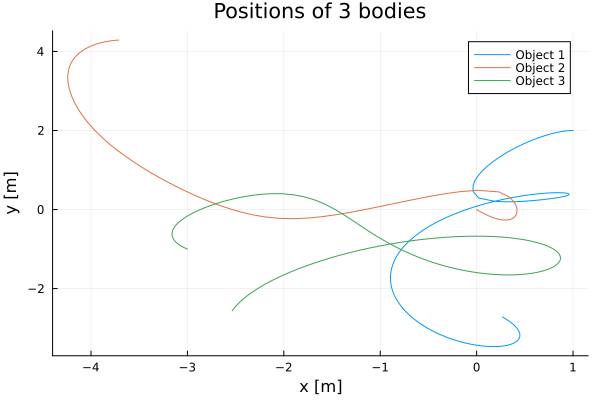

In [17]:
dt = 0.1
n_steps = 200

r_values, v_values = leapfrog_integration(dt, n_steps, r_start, v_start, masses, G)

plot(r_values[:,1,1], r_values[:,1,2], label = "Object 1")
plot!(r_values[:,2,1], r_values[:,2,2], label = "Object 2")
plot!(r_values[:,3,1], r_values[:,3,2], label = "Object 3")
plot!(xlabel = "x [m]", ylabel = "y [m]", title = "Positions of 3 bodies")

Initial total energy = -0.8384413615167958
Final total energy = 34.35555215598424
Absolute energy error: 35.193993517501035
Relative energy error: -41.975497790129026


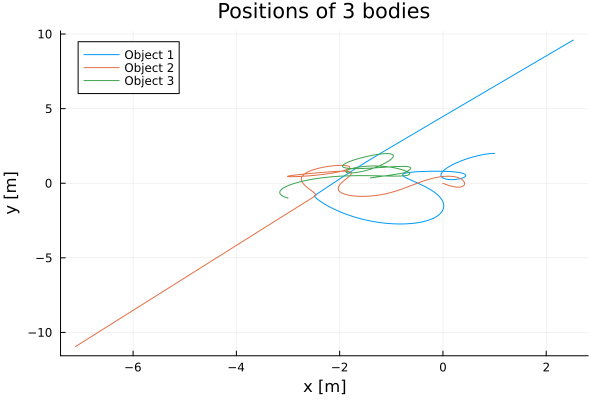

In [18]:
dt = 0.01
n_steps = 2000

r_values, v_values = leapfrog_integration(dt, n_steps, r_start, v_start, masses, G)

plot(r_values[:,1,1], r_values[:,1,2], label = "Object 1")
plot!(r_values[:,2,1], r_values[:,2,2], label = "Object 2")
plot!(r_values[:,3,1], r_values[:,3,2], label = "Object 3")
plot!(xlabel = "x [m]", ylabel = "y [m]", title = "Positions of 3 bodies")

Initial total energy = -0.8384413615167958
Final total energy = -0.8384422268169582
Absolute energy error: -8.653001624114864e-7
Relative energy error: 1.0320342031386683e-6


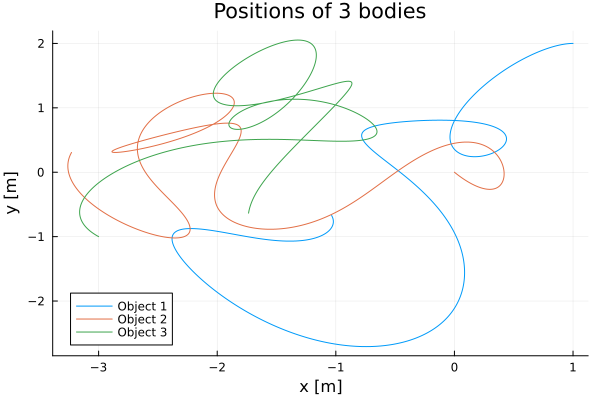

In [19]:
dt = 0.001
n_steps = 20000

r_values, v_values = leapfrog_integration(dt, n_steps, r_start, v_start, masses, G)

plot(r_values[:,1,1], r_values[:,1,2], label = "Object 1")
plot!(r_values[:,2,1], r_values[:,2,2], label = "Object 2")
plot!(r_values[:,3,1], r_values[:,3,2], label = "Object 3")
plot!(xlabel = "x [m]", ylabel = "y [m]", title = "Positions of 3 bodies")

In [20]:
dt = 0.0001
n_steps = 200000

r_values, v_values = leapfrog_integration(dt, n_steps, r_start, v_start, masses, G)

plot(r_values[:,1,1], r_values[:,1,2], label = "Object 1")
plot!(r_values[:,2,1], r_values[:,2,2], label = "Object 2")
plot!(r_values[:,3,1], r_values[:,3,2], label = "Object 3")
plot!(xlabel = "x [m]", ylabel = "y [m]", title = "Positions of 3 bodies")

Initial total energy = -0.8384413615167958
Final total energy = -0.8384413700979669
Absolute energy error: -8.581171107024943e-9
Relative energy error: 1.0234670545714775e-8


It's apparent that the error decreases by 100 each time timestep decreases by 10

## Animation

In [21]:
function animate_movement(r_results, every_nth_step=5, every_nth_frame=1)
    n_steps, n_bodies, dimensions = size(r_results)

    # Define colors and labels for each body
    colors = [:red, :blue, :green, :purple]  # Add more colors if needed
    labels = ["Body 1", "Body 2", "Body 3", "Body 4"]  # Add more labels if needed

    # Create a plot with initial positions
    plt = plot(aspect_ratio=:equal,
        legend=:outertopright,
        xlabel = "x [m]",
        ylabel = "y [m]",
        title= "Simulation of 3 bodies")

    for i in 1:n_bodies
        scatter!(plt, [r_results[1, i, 1]], [r_results[1, i, 2]], color=colors[i], label=labels[i])
    end
    
    # Update the plot for each timestep
    anim = @animate for step in 1:every_nth_step:n_steps
        scatter!([r_results[step, i, 1] for i in 1:n_bodies],
            [r_results[step, i, 2] for i in 1:n_bodies],
            color=colors[1:n_bodies], label=false)
    end every every_nth_frame

    gif(anim, "3_bodies.gif")
end

animate_movement (generic function with 3 methods)

[ Info: Saved animation to C:\Users\filip\Documents\Studia\MOwNiT\lab10\3_bodies.gif


Plots.AnimatedGif("C:\\Users\\filip\\Documents\\Studia\\MOwNiT\\lab10\\3_bodies.gif")
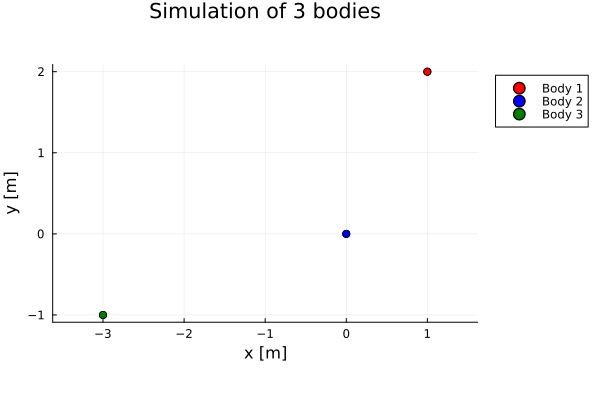

In [22]:
# Animate the movement
animate_movement(r_values, 1000, 1)

# Bonus extention: N-body simulation

## Initial conditions

In [23]:
r_start = [
    -1.0 0.0 0.0;
    1.0 0.0 0.0;
    -6.0 -6.0 0.0;
    6.0 6.0 0.0
]

v_start = [
    0.0 0.3 0.0; 
    0.0 -0.3 0.0; 
    0.4 -0.4 0.0;
    -0.4 0.41 0.0
]

masses = [1.0, 1.0, 1.0, 1.0];

dt = 0.01
n_steps = 100000
G = 1;

## Plot

In [24]:
r_values, v_values = leapfrog_integration(dt, n_steps, r_start, v_start, masses, G)

plot(r_values[:,1,1], r_values[:,1,2], label = "Object 1")
plot!(r_values[:,2,1], r_values[:,2,2], label = "Object 2")
plot!(r_values[:,3,1], r_values[:,3,2], label = "Object 3")
plot!(r_values[:,4,1], r_values[:,4,2], label = "Object 4")
plot!(xlabel = "x [m]", ylabel = "y [m]", title = "Positions of 4 bodies")

Initial total energy = -0.6178797827833269
Final total energy = -0.6178797580698348
Absolute energy error: 2.471349214161478e-8
Relative energy error: -3.999724999948915e-8


## Animation

[ Info: Saved animation to C:\Users\filip\Documents\Studia\MOwNiT\lab10\3_bodies.gif


Plots.AnimatedGif("C:\\Users\\filip\\Documents\\Studia\\MOwNiT\\lab10\\3_bodies.gif")
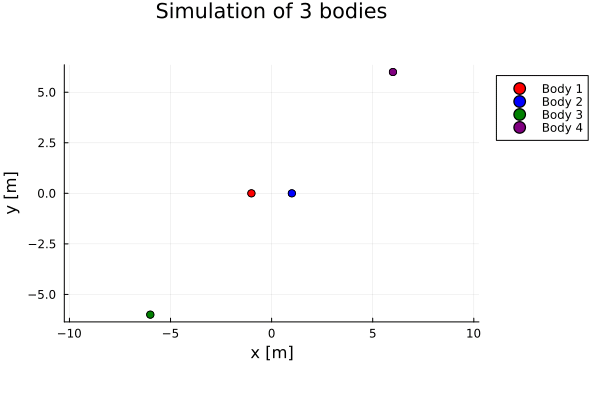

In [26]:
# Animate the movement
animate_movement(r_values, 200, 1)

# Unsuccessfull fourth-order algorithm implemention

In [51]:
function hermite_integration(dt, n_steps, r, v, G)
    m = 1.0
    n, n_dims = size(r)
    
    # Create arrays to store position, velocity, acceleration and jerk results
    r_results = zeros(n_steps, n, n_dims)
    v_results = zeros(n_steps, n, n_dims)
    a_results = zeros(n_steps, n, n_dims)
    jk_results = zeros(n_steps, n, n_dims)
    
    r_results[1, :, :] = r
    v_results[1, :, :] = v
    
    # Calculate initial acceleration
    for i in 1:n
        for j in (i+1):n
            rji = r_results[1, j, :] - r_results[1, i, :]
            rji_norm = norm(rji)
            
            # Calculate acceleration and jerk contributions
            a_results[1, i, :] += m * rji / (rji_norm^3)
            a_results[1, j, :] -= m * rji / (rji_norm^3)
        end
    end
    
    function calc_total_energy(step)
        E_pot = 0.0
        E_kin = 0.0
        
        for i in 1:n
            for j in (i+1):n
                rji = r_results[step, j, :] - r_results[step, i, :]
                rji_norm = norm(rji)
                E_pot += -G * m * m / rji_norm
            end
        end
    
        for i in 1:n
            E_kin += 0.5 * m * sum(v_results[step, i, :] .^ 2)
        end
        return E_kin + E_pot
    end
    
    # Calculate jerk for each pair of particles
    function calc_jerks!(n_step)
        for i in 1:n
            for j in (i+1):n
                rji = r_results[n_step, j, :] - r_results[n_step, i, :]
                vji = v_results[n_step, j, :] - v_results[n_step, i, :]
    
                rji_norm = norm(rji)
                rv = dot(rji, vji) / (rji_norm^2)
                
                # Calculate acceleration and jerk contributions
                # a_results[n_step, i, :] += m * rji / (rji_norm^3)
                # a_results[n_step, j, :] -= m * rji / (rji_norm^3)
                jk_results[n_step, i, :] += m * (vji - 3 * rv * rji) / (rji_norm^3)
                jk_results[n_step, j, :] -= m * (vji - 3 * rv * rji) / (rji_norm^3)
            end
        end
    end
    
    calc_jerks!(1)

    # Calculate initial total energy
    E_tot_init = calc_total_energy(1)

    println(r_results[1,:,:])
    println(v_results[1,:,:])
    println(a_results[1,:,:])
    println(jk_results[1,:,:])
    
    # Perform time integration
    for step in 2:n_steps
        
        
        for i in 1:n
            #r_results[step, i, k] = r_results[step-1, i, k] + ((v_results[step-1, i, k] + v_results[step, i, k]) * dt / 2) + ((a_results[step-1, i, k] - a_results[step, i, k]) * dt^2 / 12)
            #v_results[step, i, k] = v_results[step-1, i, k] + ((a_results[step-1, i, k] + a_results[step, i, k]) * dt / 2) + ((jk_results[step-1, i, k] - jk_results[step, i, k]) * dt^2 / 12)
            r_results[step, i, :] = r_results[step-1, i, :] + v_results[step-1, i, :] * dt + a_results[step-1, i, :] * dt^2 / 2
        end
        
        calc_accelerations!(step)
        
        for i in 1:n
            v_results[step, i, :] = v_results[step-1, i, :] + (a_results[step-1, i, :] + a_results[step, i, :]) * dt / 2
        end
    end

    # Calculate final total energy and energy errors
    E_tot_final = calc_total_energy(length(r_results[:, 1, 1]))

    println("Initial total energy = ", E_tot_init)
    println("Final total energy = ", E_tot_final)
    println("Absolute energy error: ", E_tot_final - E_tot_init)
    println("Relative energy error: ", (E_tot_final - E_tot_init) / E_tot_init)

    return r_results, v_results
end


# Usage example:
r_start = [
    1.0 2.0 0.0;
    0.0 0.0 0.0;
    -1.0 2.0 0.0
]

v_start = [
    0.1 0.8 0.0; 
    0.4 0.0 0.0; 
    -0.1 0.2 0.0
]

3×3 Matrix{Float64}:
  0.1  0.8  0.0
  0.4  0.0  0.0
 -0.1  0.2  0.0

In [52]:
dt = 0.01
n_steps = 1800
G = 1
r_values, v_values = hermite_integration(dt, n_steps, r_start, v_start, G)

plot(r_values[:,1,1], r_values[:,1,2], label = "Object 1")
plot!(r_values[:,2,1], r_values[:,2,2], label = "Object 2")
plot!(r_values[:,3,1], r_values[:,3,2], label = "Object 3")
plot!(xlabel = "x [m]", ylabel = "y [m]", title = "Positions of 3 bodies")

[1.0 2.0 0.0; 0.0 0.0 0.0; -1.0 2.0 0.0]
[0.1 0.8 0.0; 0.4 0.0 0.0; -0.1 0.2 0.0]
[-0.3394427190999916 -0.17888543819998315 0.0; 0.0 0.3577708763999663 0.0; 0.3394427190999916 -0.17888543819998315 0.0]
[0.1465981366279909 -0.007023533484006458 0.0; -0.09302042786399123 -0.14668605932398612 0.0; -0.053577708763999664 0.15370959280799257 0.0]


LoadError: UndefVarError: calc_accelerations! not defined